# Projeto Análise da Popularidade dos Candidatos a Eleição de 2022 no Brasil

## Pontos de análise:

- Total de tweets por candidato
- Media de tweets por dia por candidato

- Total de tweets com retweets por canditatos

- Total de tweets com likes por canditatos

- Assuntos mais citados dos candidatos com aplicação de modelos de análise de sentimentos:

  - **Modelo Bert**, ref.: https://huggingface.co/nlptown/bert-base-multilingual-uncased-sentiment
  
    **Description:** This a bert-base-multilingual-uncased model finetuned for sentiment analysis on product reviews in  six languages: English, Dutch, German, French, Spanish and Italian. It predicts the sentiment of the review as a number of stars (between 1 and 5). This model is intended for direct use as a sentiment analysis model for product reviews in any of the six languages above, or for further finetuning on related sentiment analysis tasks.
    
  - **Modelo Flair**, ref.: https://towardsdatascience.com/text-classification-with-state-of-the-art-nlp-library-flair-b541d7add21f
   
    **Description:** Flair delivers state-of-the-art performance in solving NLP problems such as named entity recognition (NER), part-of-speech tagging (PoS), sense disambiguation and text classification. It’s an NLP framework built on top of PyTorch.
   

    
## Analises Textuais
    
- Top assuntos mais citados nos tweets por sentimento por candidatos  (Aplicar Trigrama)
- Top assuntos mais citados nos tweets por sentimento por candidatos  (Aplicar LDA)
- Representatividade dos tweets positivos:

 - % Tweets positivos

  - % Retweets
  - % Likes
  - % Termos mais relevantes por candidato (Trigrama)
  - % Tópicos mais relevantes por candidato (LDA)


In [1]:
import pandas as pd
import numpy as np
import warnings
from helpers import ( 
    chart_tweets_trigrams,
    chart_tweets,
    chart_tweets_sentiment,
    nuvem_palavras,
    get_analysis_trigram_dataframe,
    get_dataframe_tokens,
    get_topicos,
    get_tweets_trigram,
    get_analysis_trigram,
    get_analysis_topics
)
import nltk
import spacy
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('rslp')
nltk.download('averaged_perceptron_tagger')
nlp = spacy.load("pt_core_news_lg")

[nltk_data] Downloading package punkt to /home/daholive/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/daholive/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/daholive/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package rslp to /home/daholive/nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/daholive/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [2]:
warnings.filterwarnings('ignore')

In [3]:
%matplotlib inline

In [4]:
# dataframe tweets
dataframe = pd.read_parquet("/home/daholive/Documents/twitter_ellection_brazil/datasource/tweets_preprocessing.parquet")

In [5]:
# adjust to numeric format
dataframe['flair_sentiment_accuracy'] = pd.to_numeric(dataframe['flair_sentiment_accuracy'],errors='coerce')

## Tweets por candidato (em %)

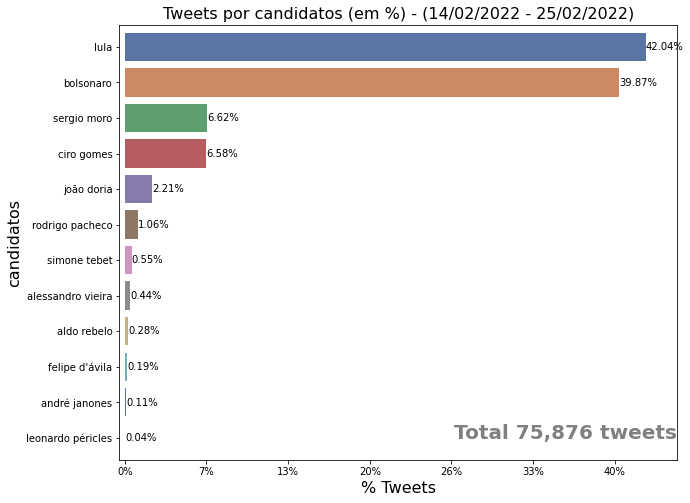

In [6]:
min_date = pd.to_datetime(dataframe["dated_at_tz"]).min().strftime("%d/%m/%Y")
max_date = pd.to_datetime(dataframe["dated_at_tz"]).max().strftime("%d/%m/%Y")

df1 = dataframe.groupby(["query"]).agg({
    "twitter_id": "nunique"
}).reset_index().rename(columns={"twitter_id":"qtde"}).sort_values(by=['qtde'], ascending=False)

chart_tweets(
    df = df1,
    params = {
        "x": "query",
        "y": "qtde",
        "annotation_w":3e4,
        "annotation_h":8,
        "x_title": "% Tweets",
        "y_title": "candidatos",
        "title":f"Tweets por candidatos (em %) - ({min_date} - {max_date})"
    }
)

## Média de tweets por candidato (em %)

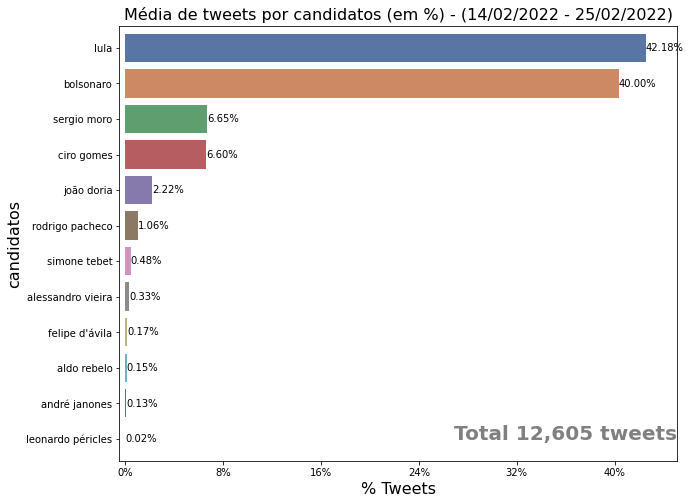

In [7]:
df2 = dataframe.groupby(["query","dated_at_tz"]).agg({
    "twitter_id": "nunique"
}).reset_index().rename(columns={"twitter_id":"qtde","dated_at_tz": "data"}).groupby([
    "query"
]).agg({
    "qtde": lambda x: round(x.mean())
}).reset_index().sort_values(by=['qtde'], ascending=False)

chart_tweets(
    df = df2,
    params = {
        "x": "query",
        "y": "qtde",
        "annotation_w":5e3,
        "annotation_h":8,
        "x_title": "% Tweets",
        "y_title": "candidatos",
        "title":f"Média de tweets por candidatos (em %) - ({min_date} - {max_date})"
    }
)

## Média de retweets por candidato (em %)

In [8]:
df3 = dataframe.groupby(["query"]).agg({
    "retweet_count": "sum"
}).reset_index().rename(columns={"retweet_count":"qtde"}).sort_values(by=['qtde'], ascending=False)

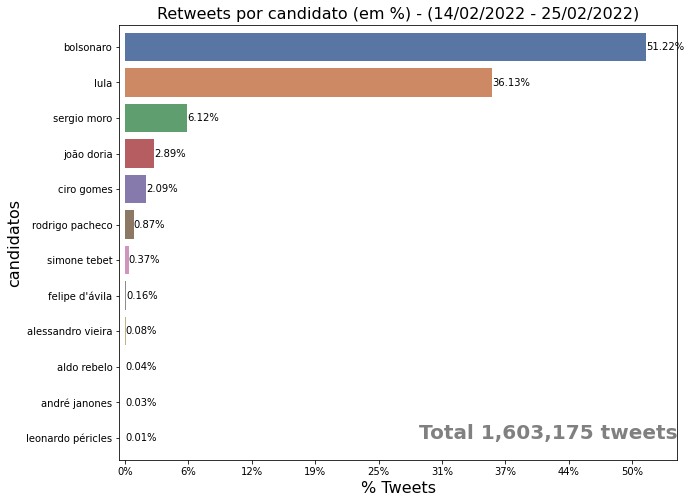

In [9]:
chart_tweets(
    df = df3,
    params = {
        "x": "query",
        "y": "qtde",
        "annotation_w":5e3,
        "annotation_h":8,
        "x_title": "% Tweets",
        "y_title": "candidatos",
        "title":f"Retweets por candidato (em %) - ({min_date} - {max_date})"
    }
)

## Média de likes por candidato (em %)

In [10]:
df4 = dataframe.groupby(["query"]).agg({
    "like_count": "sum"
}).reset_index().rename(columns={"like_count":"qtde"}).sort_values(by=['qtde'], ascending=False)

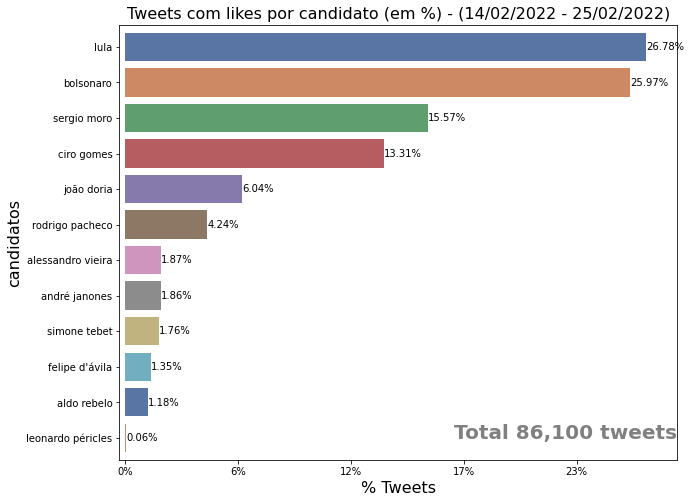

In [11]:
chart_tweets(
    df = df4,
    params = {
        "x": "query",
        "y": "qtde",
        "annotation_w":5e3,
        "annotation_h":8,
        "x_title": "% Tweets",
        "y_title": "candidatos",
        "title":f"Tweets com likes por candidato (em %) - ({min_date} - {max_date})"
    }
)

## Exploratory data analysis - Bert Model

#### Classificação dos Tweets utilizando modelo Bert (https://huggingface.co/nlptown/bert-base-multilingual-uncased-sentiment)

In [12]:
dataframe["bert_sentiment_level_text"].value_counts()

VERY_NEGATIVE    40516
VERY_POSITIVE    16598
NEUTRAL           7982
POSITIVE          7071
NEGATIVE          3709
Name: bert_sentiment_level_text, dtype: int64

#### Total de Tweets classificados como "VERY_POSITIVE" a serem analisados

In [13]:
total_tweets_unicos_positivos = dataframe[
    dataframe["bert_sentiment_level_text"]=="VERY_POSITIVE"
]["twitter_id"].nunique()
total_tweets_unicos_positivos

16598

#### Distribuição dos Tweets classificados como "VERY_POSITIVE" por candidato

In [14]:
dataframe[
    dataframe["bert_sentiment_level_text"]=="VERY_POSITIVE"
][["query","bert_sentiment_level_text"]].value_counts()

query              bert_sentiment_level_text
lula               VERY_POSITIVE                6636
bolsonaro          VERY_POSITIVE                6412
ciro gomes         VERY_POSITIVE                1539
sergio moro        VERY_POSITIVE                1186
joão doria         VERY_POSITIVE                 444
rodrigo pacheco    VERY_POSITIVE                 130
aldo rebelo        VERY_POSITIVE                  78
simone tebet       VERY_POSITIVE                  65
alessandro vieira  VERY_POSITIVE                  61
felipe d'ávila     VERY_POSITIVE                  24
andré janones      VERY_POSITIVE                  13
leonardo péricles  VERY_POSITIVE                  10
dtype: int64

#### Total de autores dos Tweets

In [15]:
total_tweets_autores_unicos_positivos = dataframe[
    dataframe["bert_sentiment_level_text"]=="VERY_POSITIVE"
]["author_id"].nunique()
total_tweets_autores_unicos_positivos

11920

#### Tabela analítica dos percentuais de tweets, retweets, likes e usuários ativos (autores) por candidato em percenutal

In [16]:
# percentual de tweets positivos por candidato
dataframe[
    dataframe["bert_sentiment_level_text"]=="VERY_POSITIVE"
].groupby(["query"]).agg({
    "twitter_id": lambda x: round(len(x)/total_tweets_unicos_positivos,4)*100,
    "have_retweet": lambda x: round(sum(x)/total_tweets_unicos_positivos,4)*100,
    "have_like": lambda x: round(sum(x)/total_tweets_unicos_positivos,4)*100,
    "author_id": lambda x: round(len(np.unique(x))/total_tweets_autores_unicos_positivos,4)*100
}).reset_index().rename(
    columns={
        "twitter_id":"perc_tweets",
        "have_retweet": "perc_retweets",
        "have_like": "perc_like",
        "author_id": "perc_active_users",
    }
).sort_values(by = "perc_tweets", ascending=False)

,query,perc_tweets,perc_retweets,perc_like,perc_active_users
8,lula,39.98,12.93,6.48,43.17
3,bolsonaro,38.63,14.51,5.04,45.48
4,ciro gomes,9.27,4.63,3.40,6.23
10,sergio moro,7.15,3.40,1.98,6.53
6,joão doria,2.68,1.14,0.88,2.54
9,rodrigo pacheco,0.78,0.33,0.16,0.95
0,aldo rebelo,0.47,0.32,0.25,0.52
11,simone tebet,0.39,0.17,0.17,0.48
1,alessandro vieira,0.37,0.16,0.15,0.50
5,felipe d'ávila,0.14,0.08,0.04,0.18


#### Função GET_ANALYSIS_TRIGRAM
Função que consolida outras funções em um único pipeline de análise:
   - Processa os termos mais citados, através da identificação dos trigramas com melhor SCORE, aplicando o método estatístico Teste-t de Student
   - Gera gráfico dos TOP 20 termos mais relevantes
   - Gera Wordcloud dos termos

#### Função aplicada para o candidato LULA

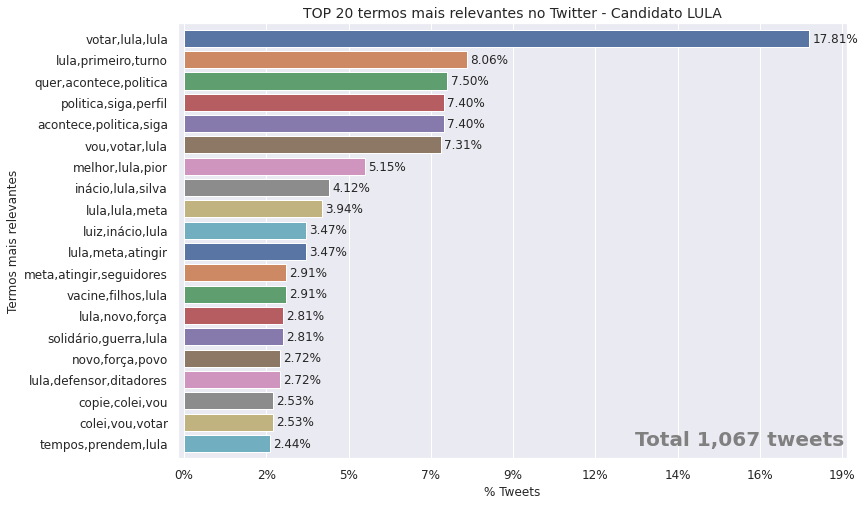

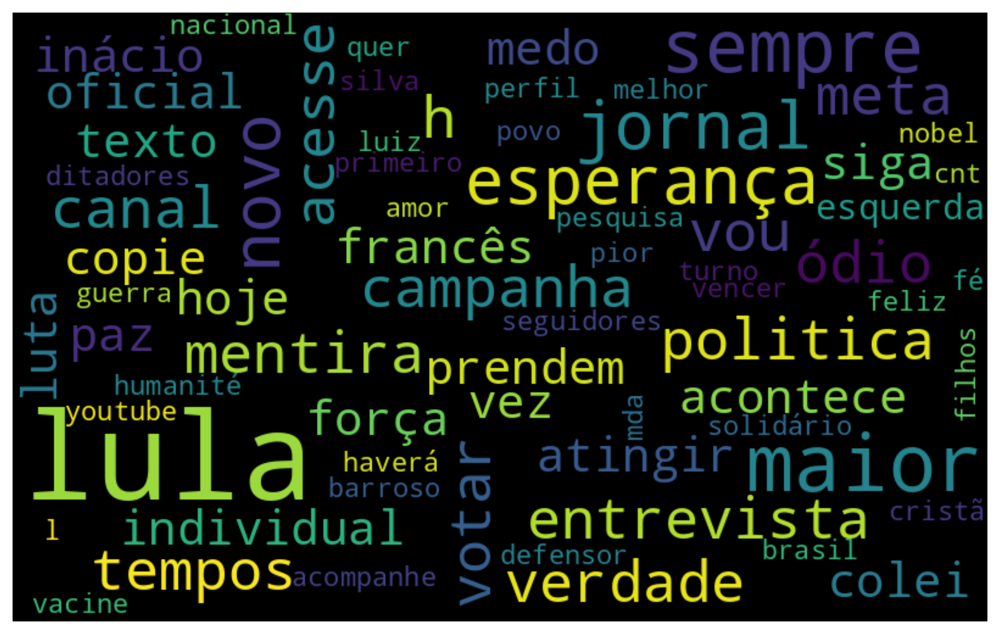

Finished: 59.648357629776


In [17]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="lula", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=True
)

#### Função aplicada para o candidato BOLSONARO

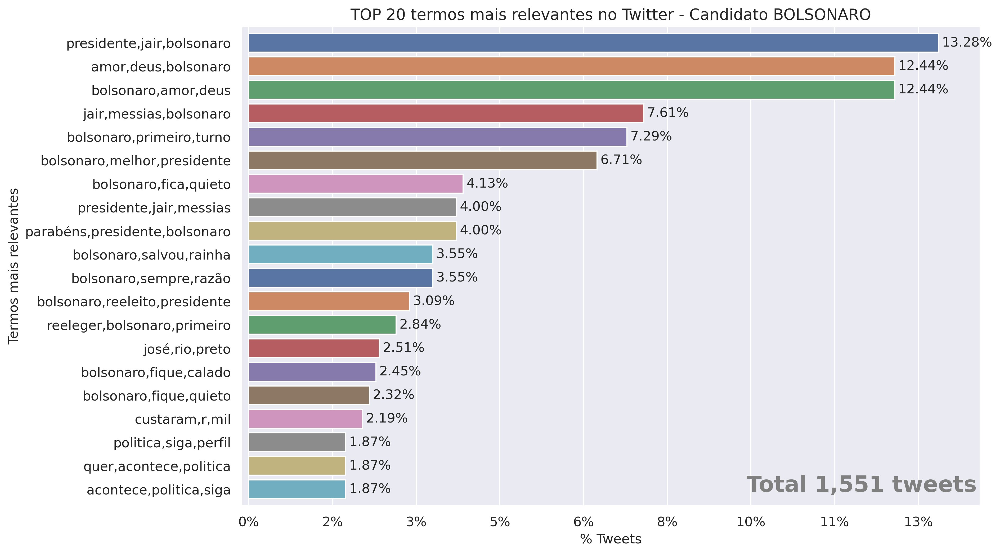

Finished: 54.2503023147583


In [18]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="bolsonaro", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato SERGIO MORO

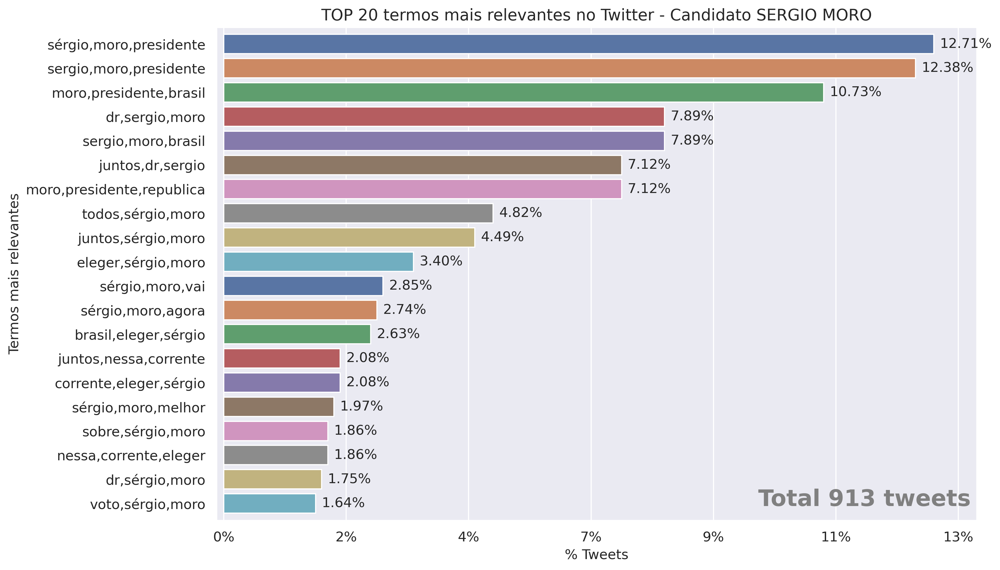

Finished: 9.843285083770752


In [19]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="sergio moro", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato CIRO GOMES

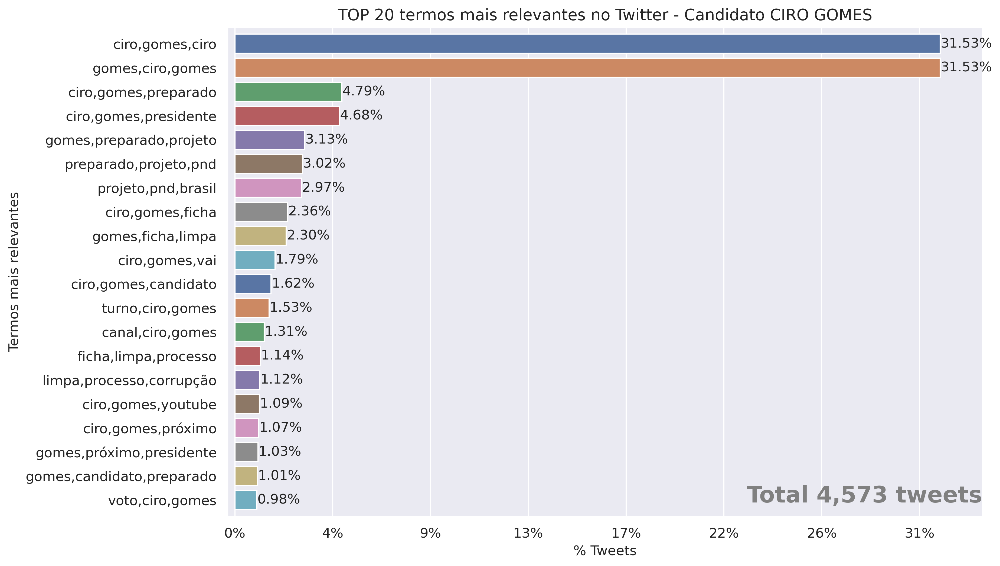

Finished: 11.95229196548462


In [20]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="ciro gomes", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato JOÃO DORIA

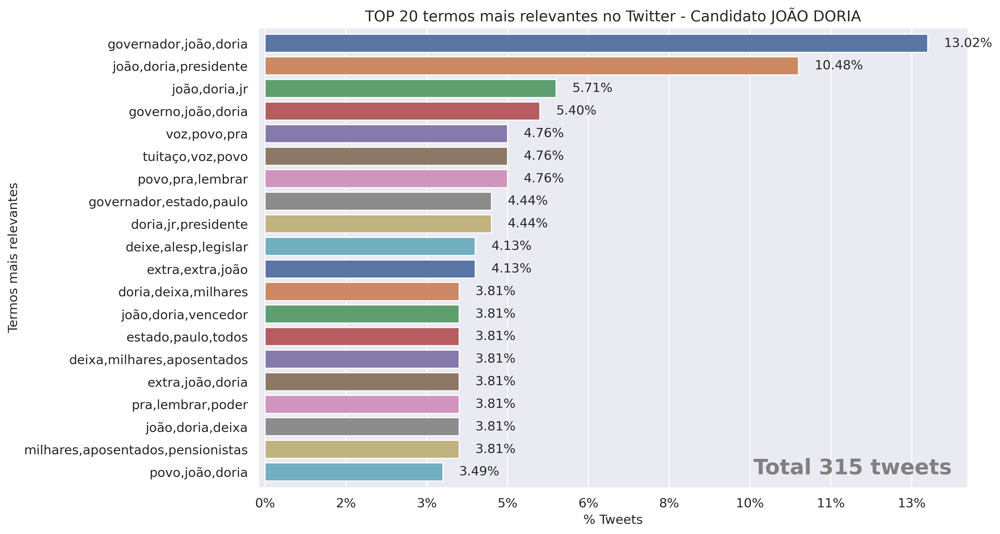

Finished: 4.405893802642822


In [21]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="joão doria", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato RODRIGO PACHECO

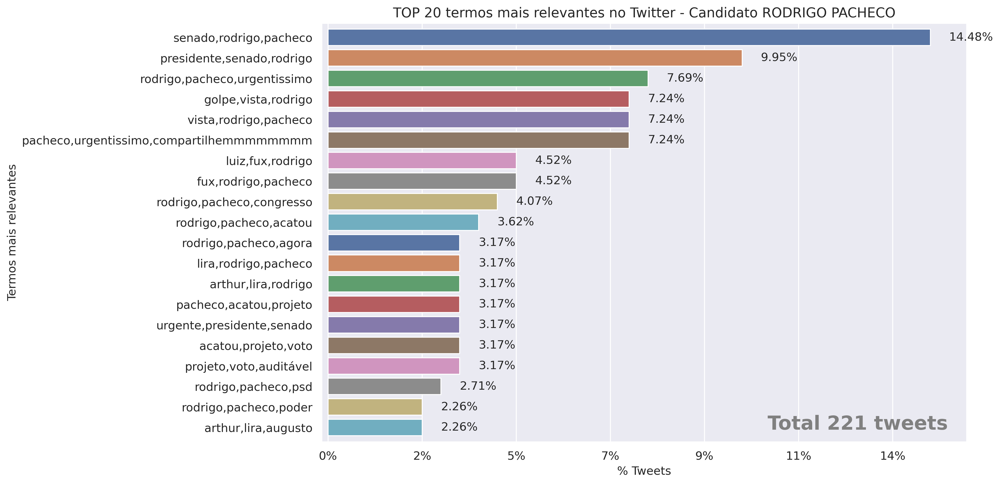

Finished: 1.98860502243042


In [22]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="rodrigo pacheco", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato SIMONE TEBET

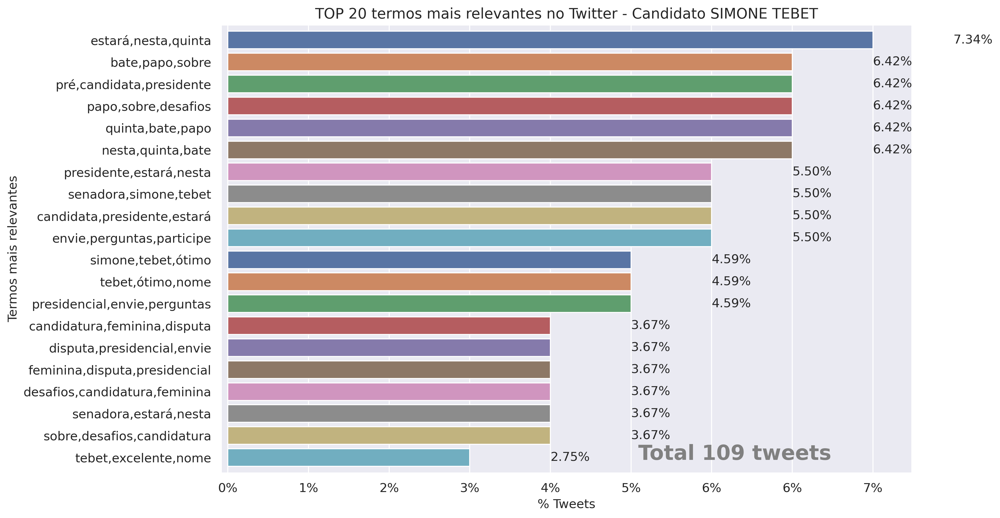

Finished: 1.393446922302246


In [23]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="simone tebet", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato ALESSANDRO VIEIRA

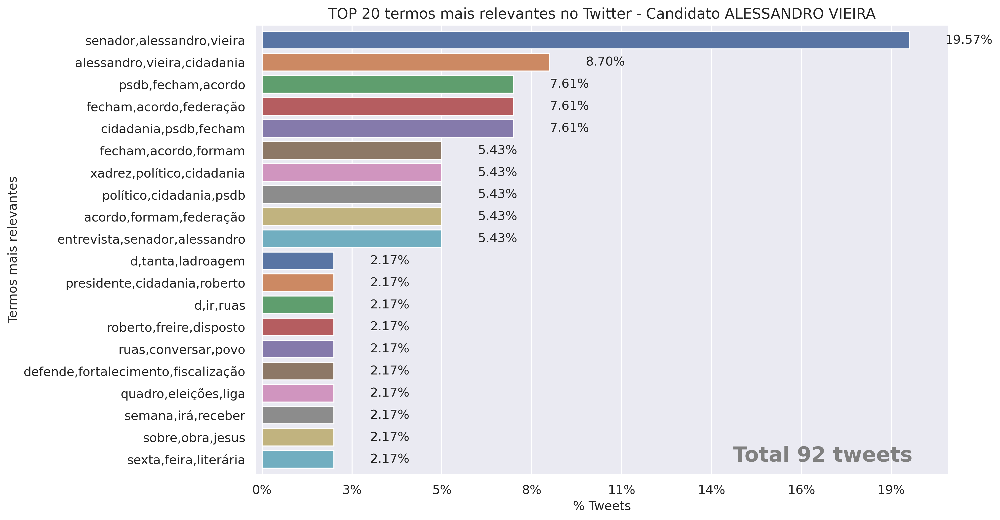

Finished: 1.3455677032470703


In [24]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="alessandro vieira", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato ALDO RABELO

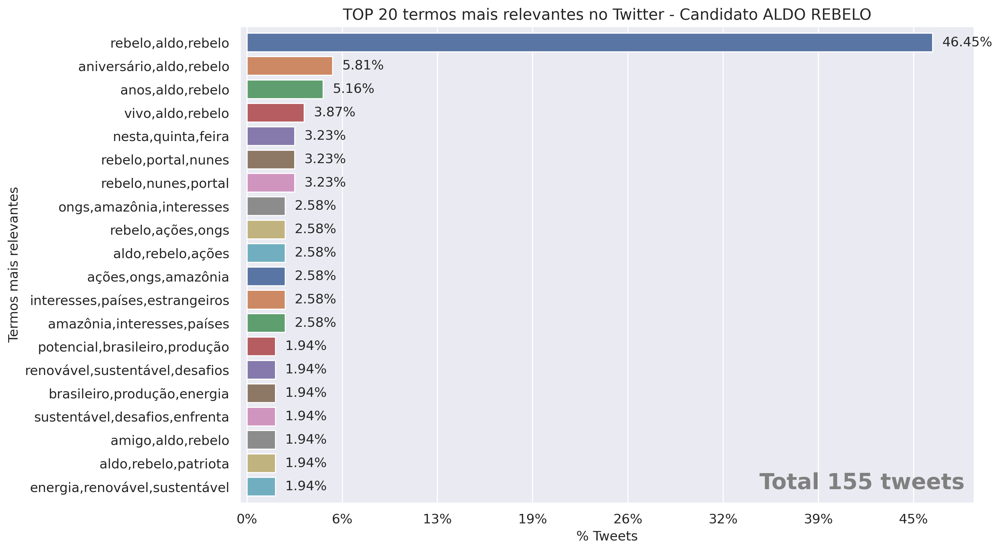

Finished: 1.557093858718872


In [25]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="aldo rebelo", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato FELIPE D'AVILA

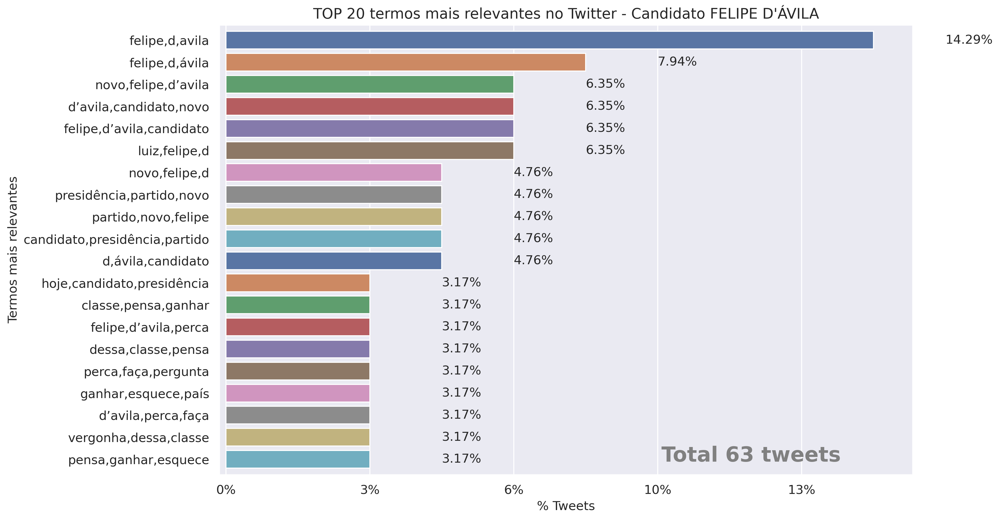

Finished: 1.0341143608093262


In [26]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="felipe d'ávila", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato ANDRÉ JANONES

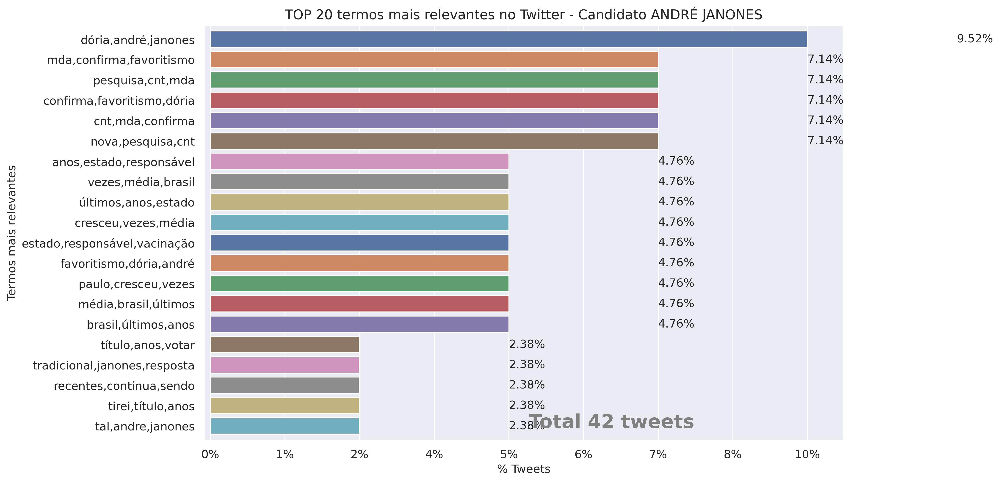

Finished: 1.0565361976623535


In [27]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="andré janones", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato LEONARDO PÉRICLES

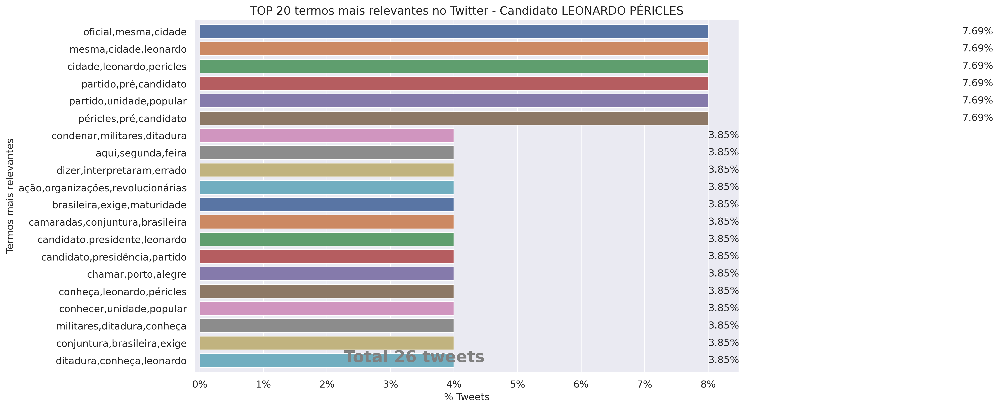

Finished: 1.1802122592926025


In [28]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="bert", 
    candidate="leonardo péricles", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

## Exploratory data analysis - Bert FLAIR

#### Classificação dos Tweets utilizando modelo Flair (https://github.com/flairNLP/flair)

In [29]:
dataframe["flair_sentiment_text"].value_counts()

NEGATIVE    48466
POSITIVE    27410
Name: flair_sentiment_text, dtype: int64

#### Total de Tweets classificados como "POSITIVE" e acurácia do modelo maior ou igual a 90% a  serem analisados

In [30]:
total_tweets_unicos_positivos = dataframe[
    (dataframe["flair_sentiment_text"]=="POSITIVE") & 
    (dataframe["flair_sentiment_accuracy"]>=0.90) 
]["twitter_id"].nunique()
total_tweets_unicos_positivos

18154

#### Distribuição dos Tweets classificados como "POSITIVE" por candidato

In [31]:
dataframe[
    (dataframe["flair_sentiment_text"]=="POSITIVE") & 
    (dataframe["flair_sentiment_accuracy"]>=0.90) 
].groupby(["query"]).agg({
    "twitter_id": lambda x: round(len(x)/total_tweets_unicos_positivos,4)*100,
    "have_retweet": lambda x: round(sum(x)/total_tweets_unicos_positivos,4)*100,
    "have_like": lambda x: round(sum(x)/total_tweets_unicos_positivos,4)*100,
    "author_id": lambda x: round(len(np.unique(x))/total_tweets_autores_unicos_positivos,4)*100
}).reset_index().rename(
    columns={
        "twitter_id":"perc_tweets",
        "have_retweet": "perc_retweets",
        "have_like": "perc_like",
        "author_id": "perc_active_users",
    }
).sort_values(by = "perc_tweets", ascending=False)

,query,perc_tweets,perc_retweets,perc_like,perc_active_users
3,bolsonaro,37.67,13.58,5.22,47.23
8,lula,37.48,10.93,6.87,45.51
4,ciro gomes,12.76,6.04,4.80,8.62
10,sergio moro,6.49,2.89,1.83,6.59
6,joão doria,2.65,1.15,0.93,2.67
9,rodrigo pacheco,0.92,0.40,0.31,1.29
11,simone tebet,0.67,0.27,0.25,0.90
1,alessandro vieira,0.54,0.23,0.25,0.74
0,aldo rebelo,0.47,0.32,0.28,0.54
5,felipe d'ávila,0.15,0.06,0.04,0.21


#### Total de autores dos Tweets

In [32]:
total_tweets_autores_unicos_positivos = dataframe[
    (dataframe["flair_sentiment_text"]=="POSITIVE") & 
    (dataframe["flair_sentiment_accuracy"]>=0.90) 
]["author_id"].nunique()
total_tweets_autores_unicos_positivos

12717

#### Função GET_ANALYSIS_TRIGRAM
Função que consolida outras funções em um único pipeline de análise:
   - Processa os termos mais citados, através da identificação dos trigramas com melhor SCORE, aplicando o método estatístico Teste-t de Student
   - Gera gráfico dos TOP 20 termos mais relevantes
   - Gera Wordcloud dos termos

#### Função aplicada para o candidato LULA

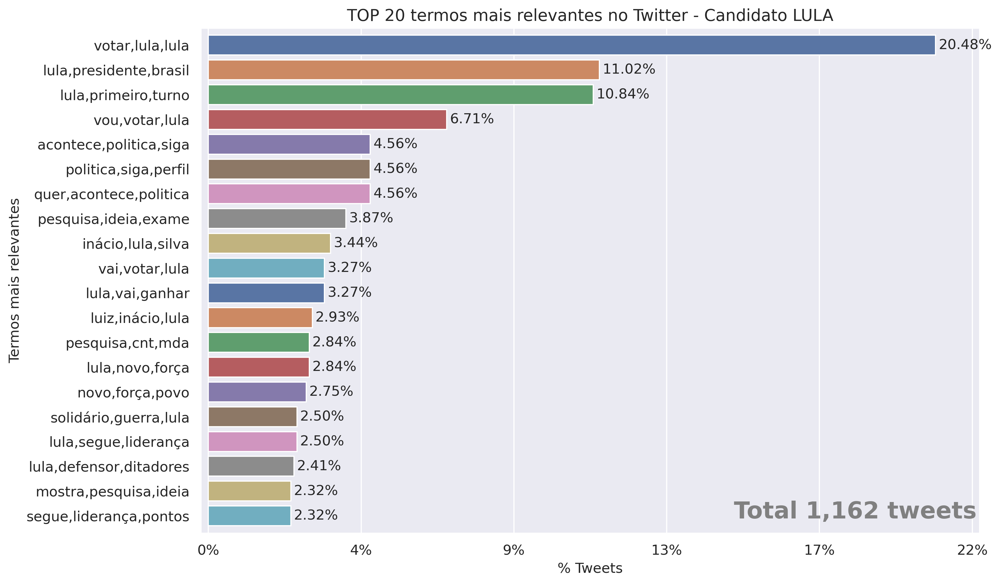

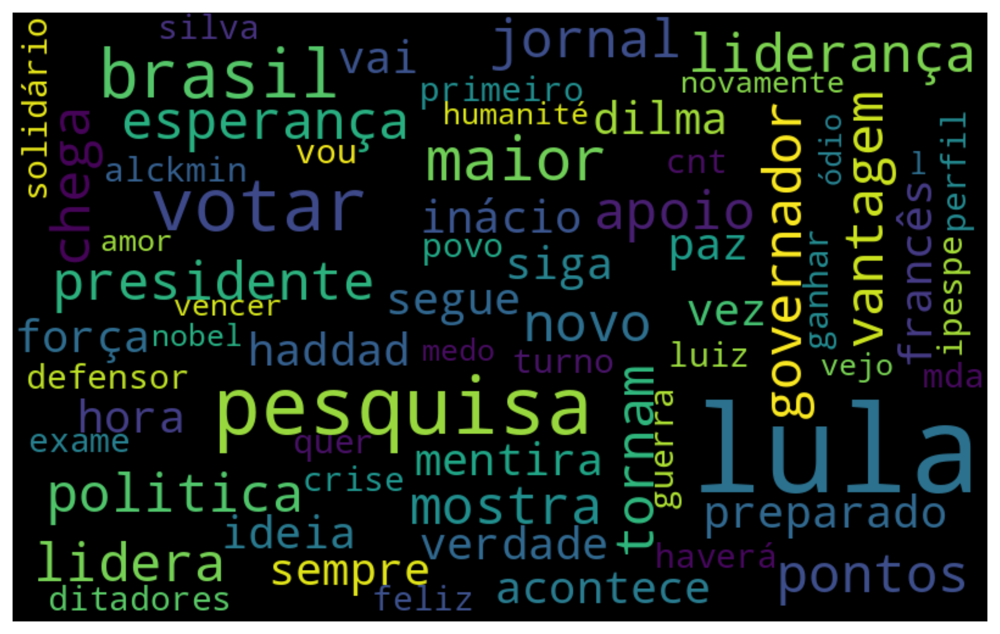

Finished: 60.22979664802551


In [33]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="lula", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=True
)

#### Função aplicada para o candidato BOLSONARO

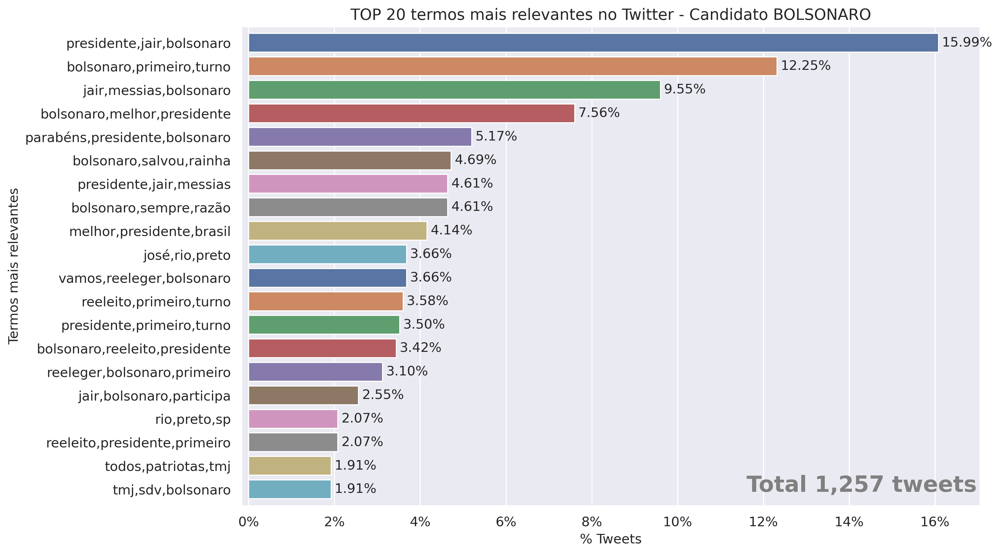

Finished: 58.19952130317688


In [34]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="bolsonaro", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato SERGIO MORO

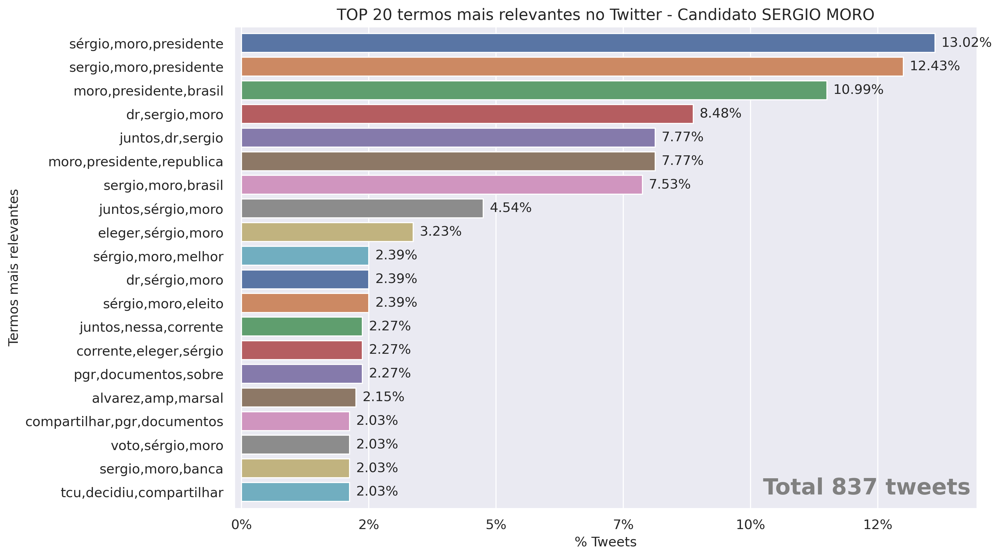

Finished: 9.953444957733154


In [35]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="sergio moro", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato CIRO GOMES

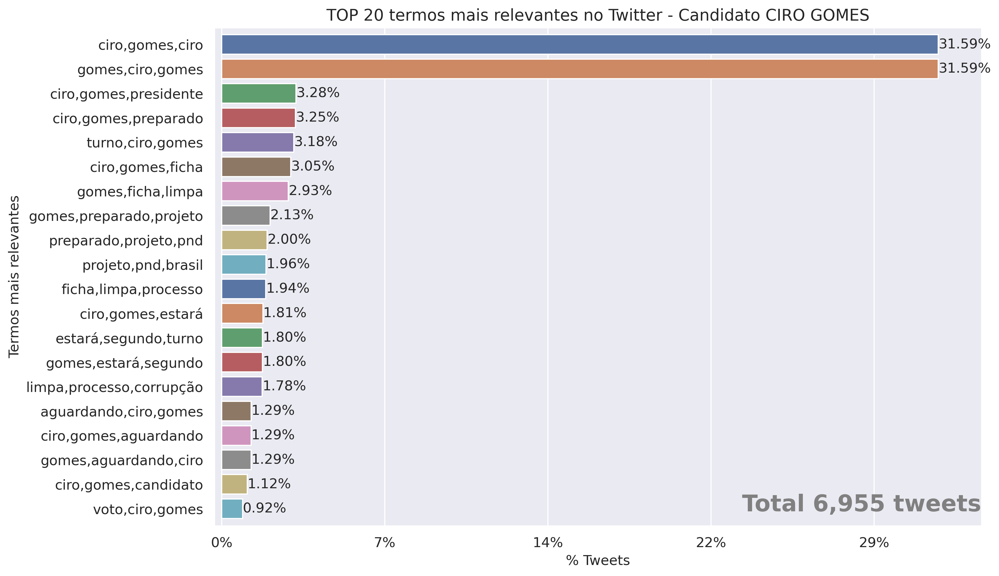

Finished: 17.497204780578613


In [36]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="ciro gomes", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato JOÃO DORIA

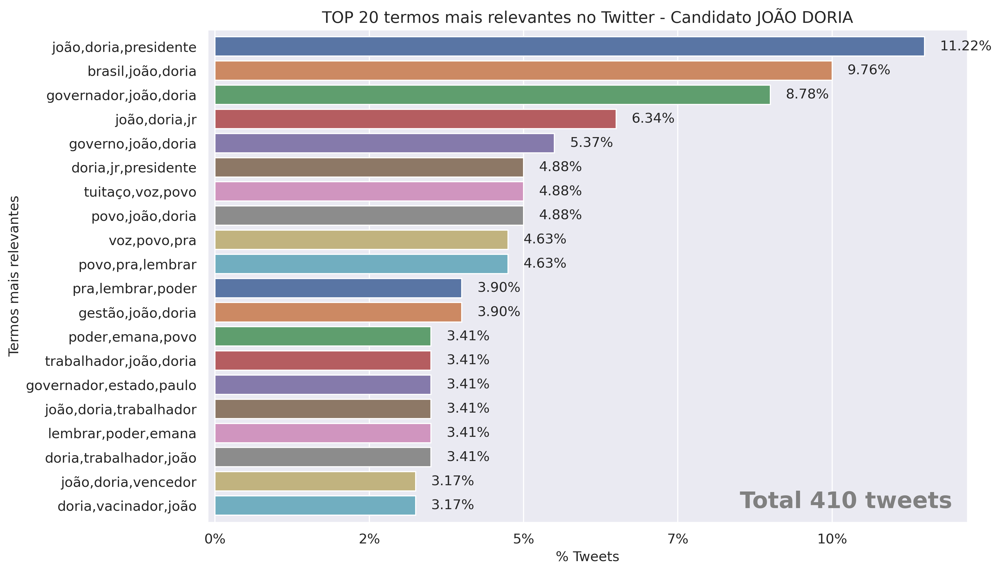

Finished: 4.4265220165252686


In [37]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="joão doria", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato RODRIGO PACHECO

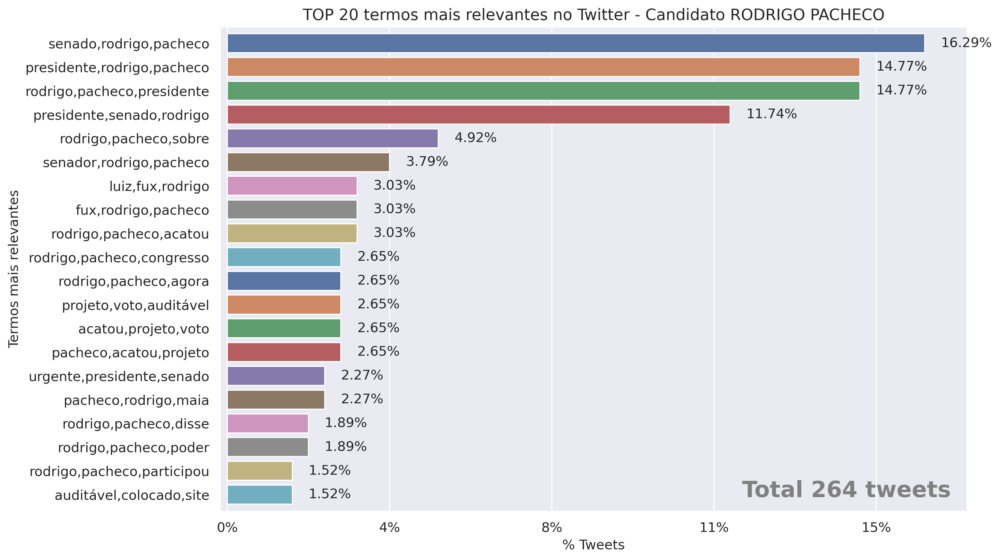

Finished: 2.297269344329834


In [38]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="rodrigo pacheco", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato SIMONE TEBET

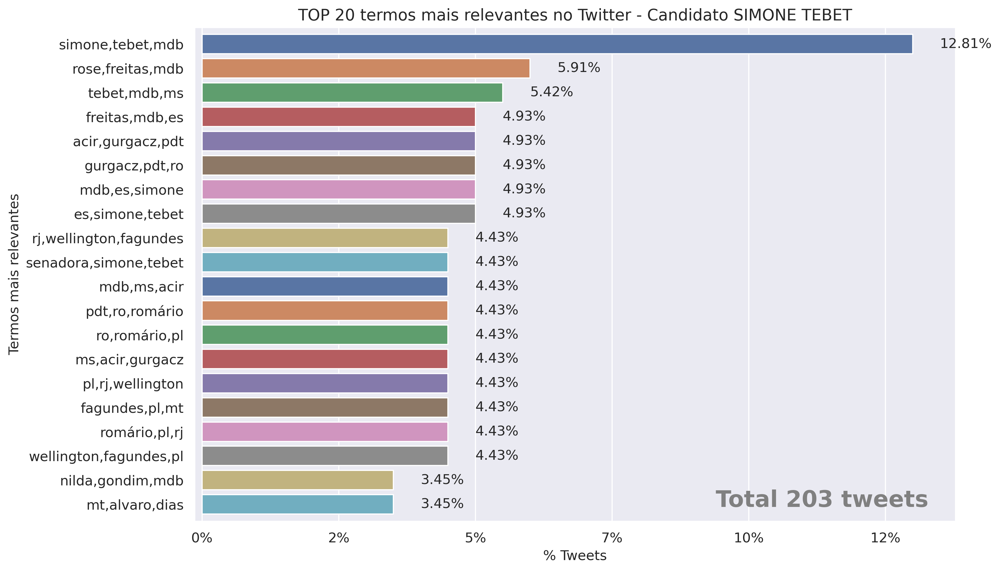

Finished: 1.8591887950897217


In [39]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="simone tebet", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato ALESSANDRO VIEIRA

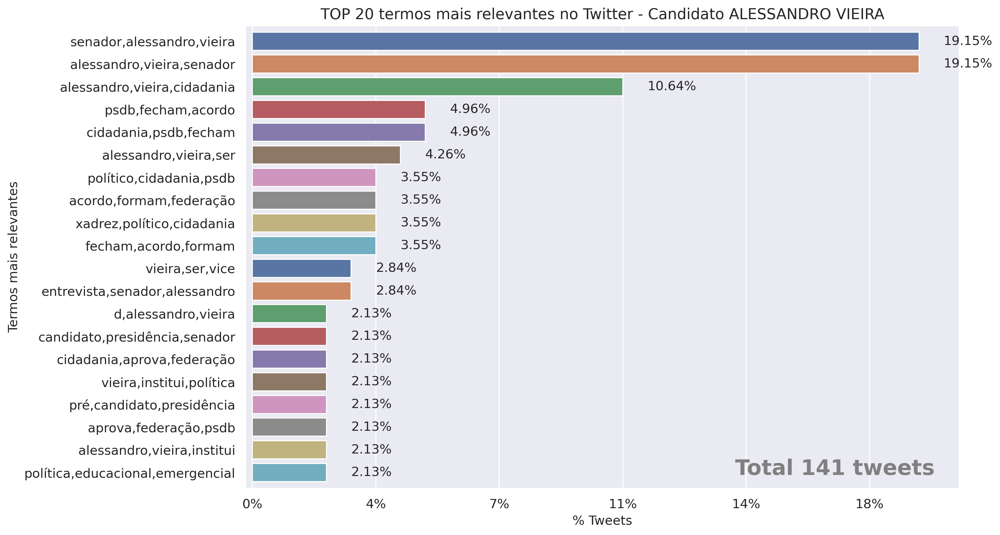

Finished: 1.6580369472503662


In [40]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="alessandro vieira", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato ALDO RABELO

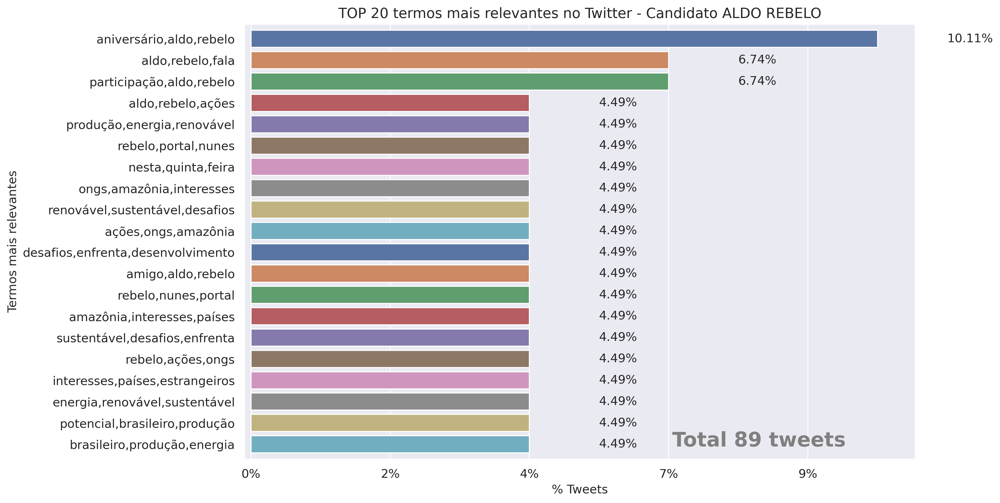

Finished: 1.5686683654785156


In [41]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="aldo rebelo", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato FELIPE D'AVILA

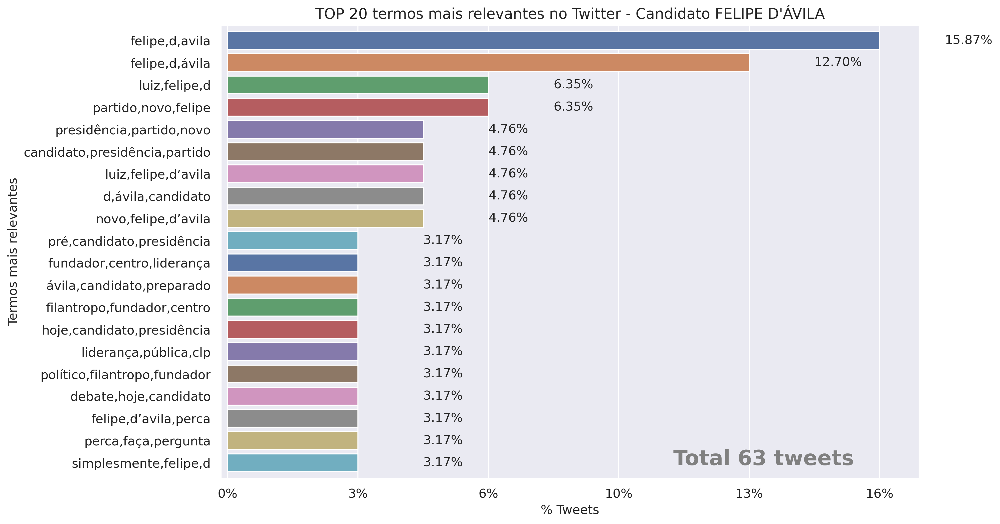

Finished: 1.130528211593628


In [42]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="felipe d'ávila", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato ANDRÉ JANONES

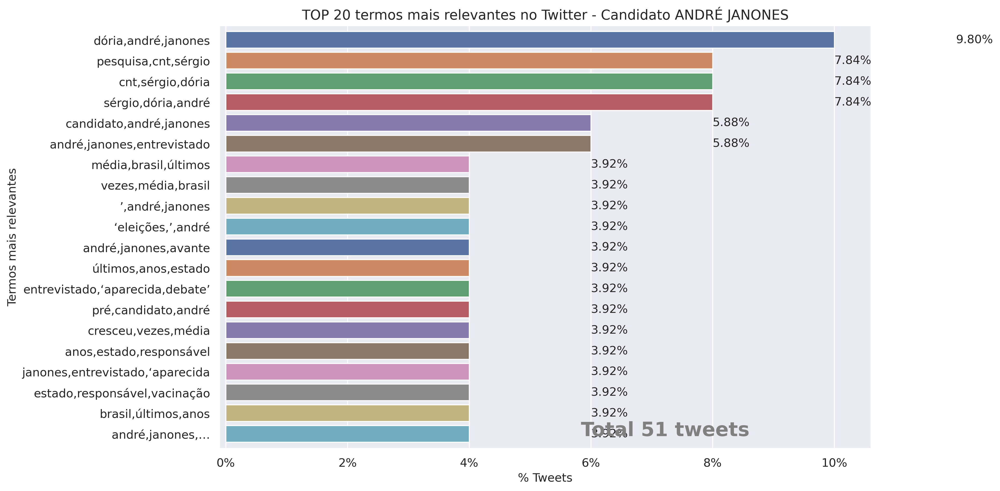

Finished: 1.1406772136688232


In [43]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="andré janones", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

#### Função aplicada para o candidato LEONARDO PÉRICLES

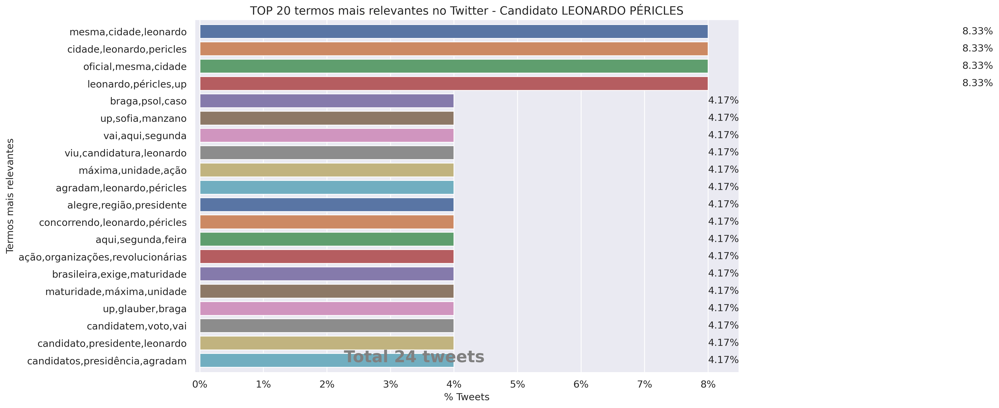

Finished: 1.1840524673461914


In [44]:
get_analysis_trigram(
    dataframe=dataframe, 
    model="flair", 
    candidate="leonardo péricles", 
    num_trigram=50, 
    chart_limit_terms=20,
    model_stats="Teste-t",
    wordcloud=False
)

## Exploratory data analysis - Análise de tópicos - Bert Model

#### Função GET_ANALYSIS_TOPICS
Função que consolida outras funções em um único pipeline de análise:
   - Processa os tópicos mais citados, através da aplicação do modelo LDA (Latent Dirichlet allocation),que é um modelo estatístico generativo. Ele permite que conjuntos de observações sejam explicados por variáveis latentes que explicam por que algumas partes dos dados são semelhantes.
   - Gera gráfico dos TOP 20 tópicos mais relevantes
   - Gera Wordcloud dos tópicos

#### Função aplicada para o candidato Lula

done in 3.785s.


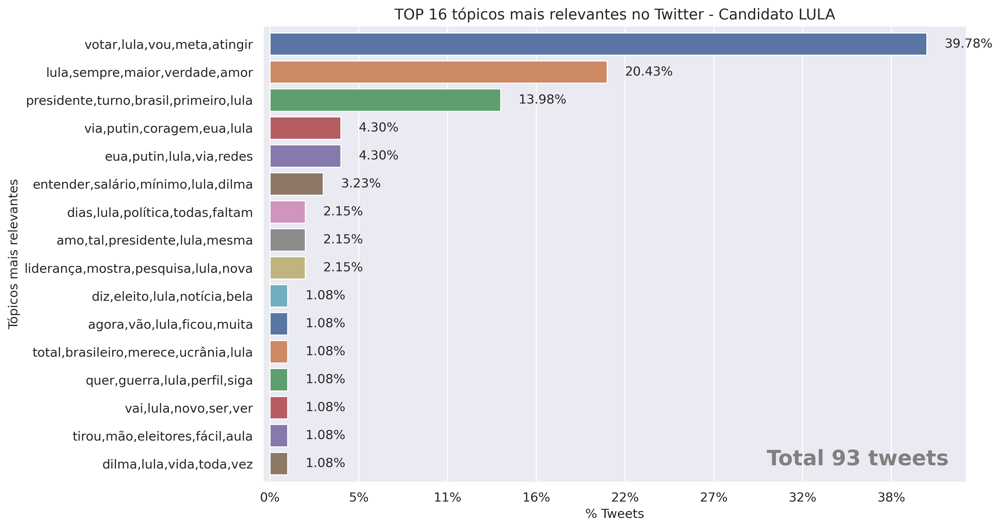

In [45]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="lula", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)

#### Função aplicada para o candidato bolsonaro

done in 3.681s.


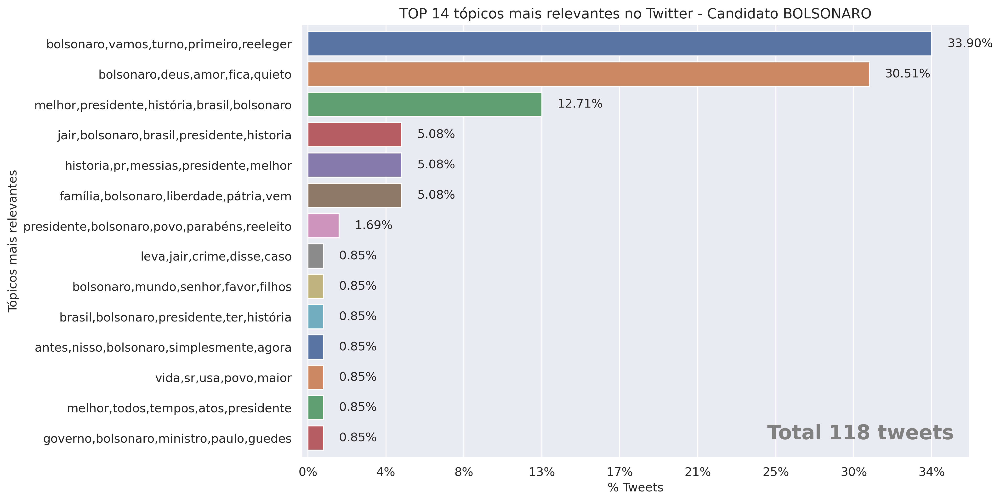

In [46]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="bolsonaro", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)

#### Função aplicada para o candidato ciro gomes

done in 0.956s.


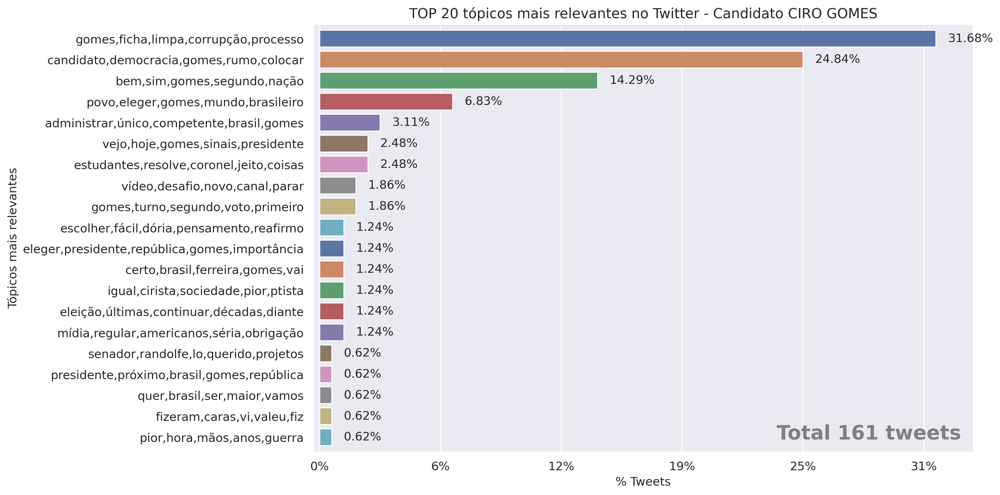

In [47]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="ciro gomes", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)

#### Função aplicada para o candidato sergio moro 

done in 0.790s.


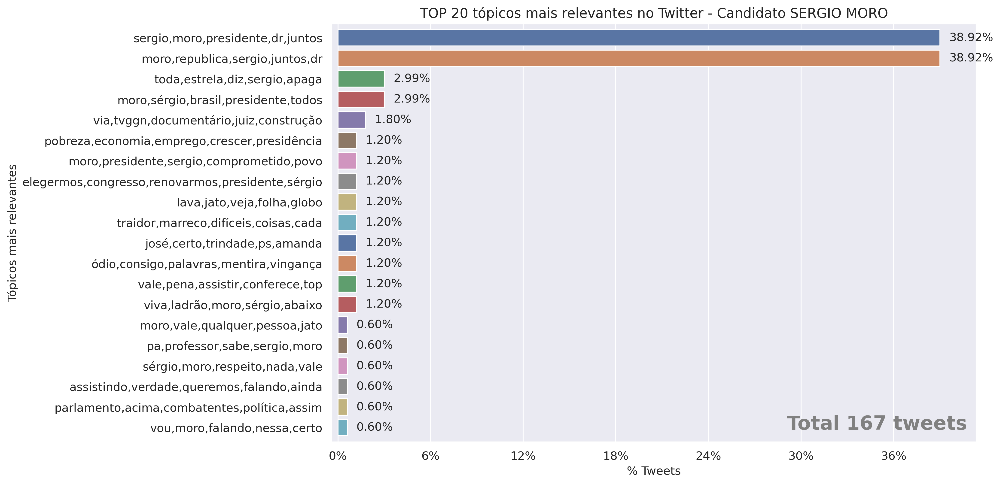

In [48]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="sergio moro", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)

#### Função aplicada para o candidato joão doria

done in 0.300s.


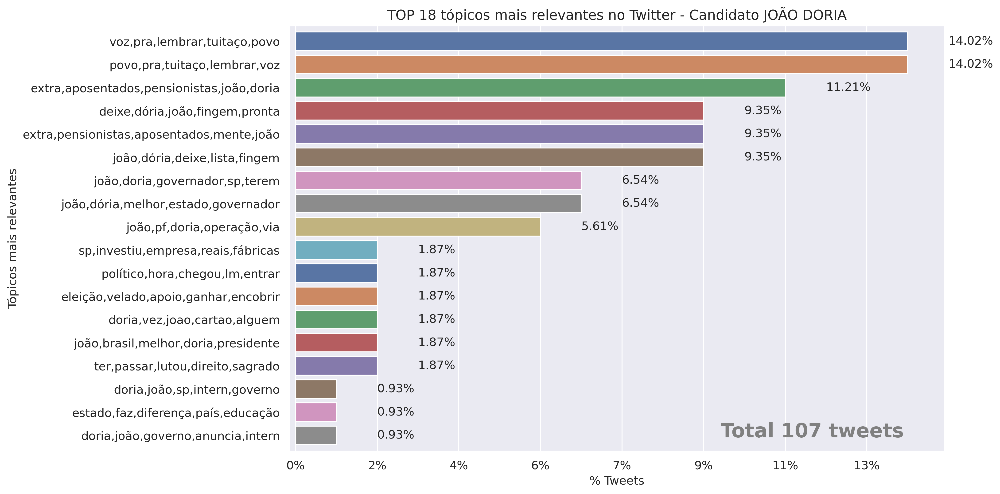

In [49]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="joão doria", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)

#### Função aplicada para o candidato rodrigo pacheco 

done in 0.103s.


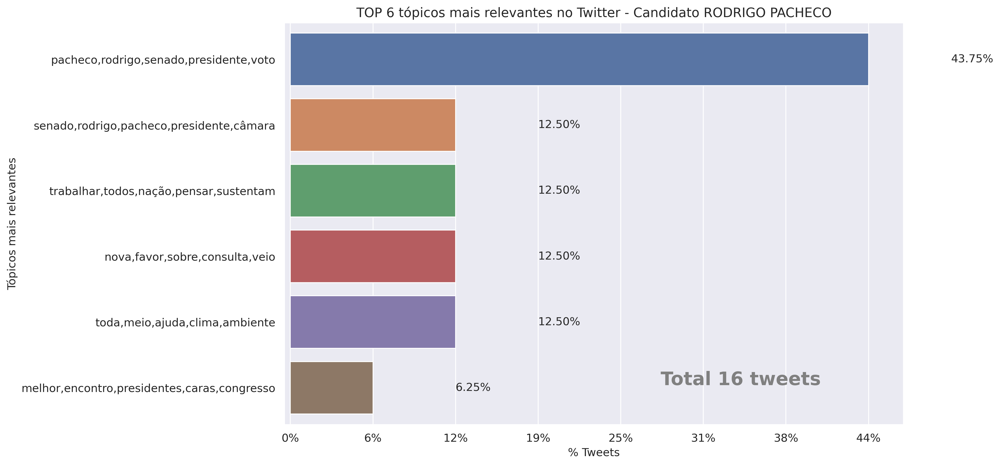

In [50]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="rodrigo pacheco", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)

#### Função aplicada para o candidato simone tebet 

done in 0.050s.


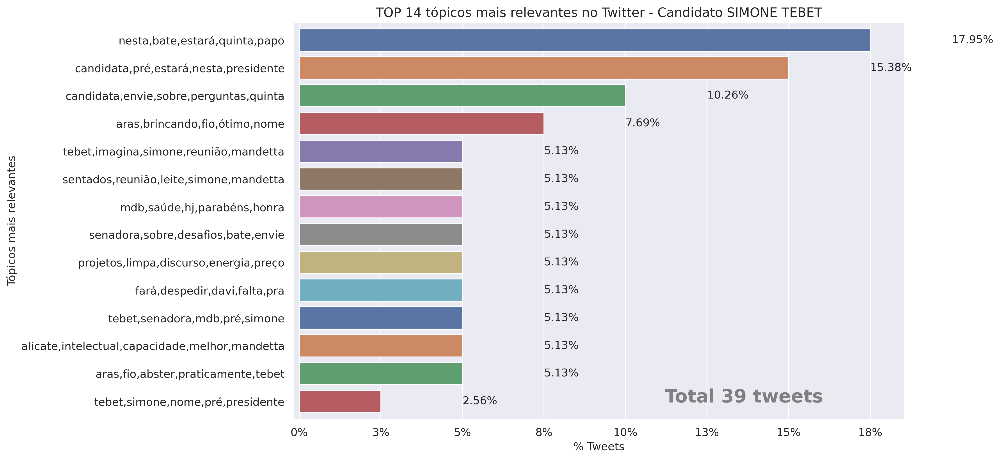

In [51]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="simone tebet", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)

#### Função aplicada para o candidato alessandro vieira

done in 0.041s.


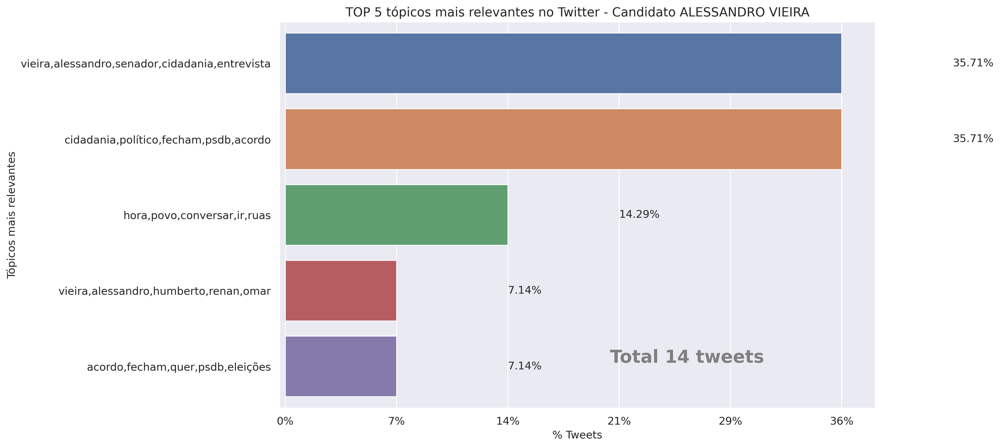

In [52]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="alessandro vieira", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)

#### Função aplicada para o candidato felipe d'ávila 

done in 0.019s.


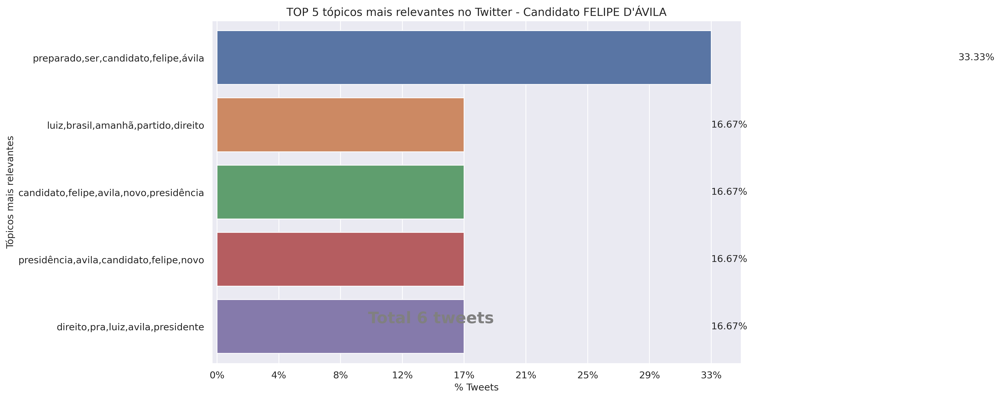

In [53]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="felipe d'ávila", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)

#### Função aplicada para o candidato andré janones

done in 0.012s.


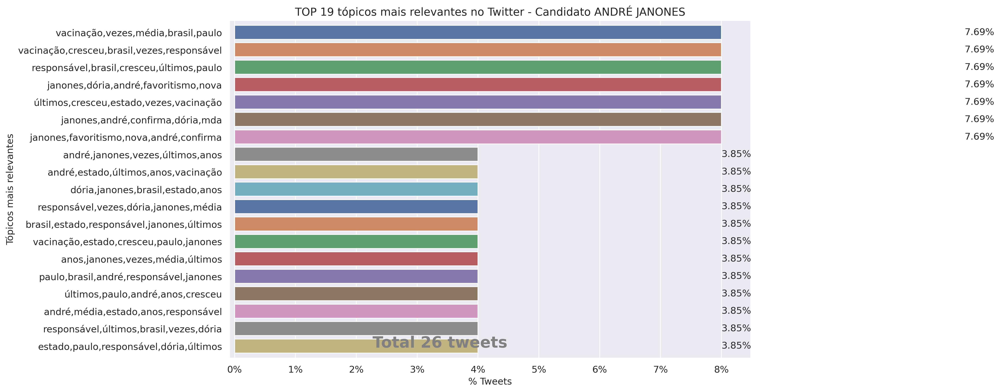

In [54]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="andré janones", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)

#### Função aplicada para o candidato leonardo péricles

done in 0.008s.


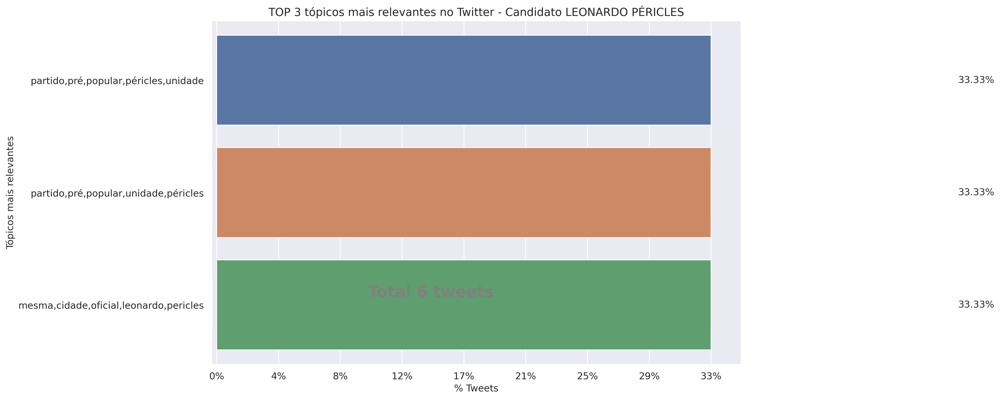

In [55]:
get_analysis_topics(
    dataframe=dataframe, 
    model="bert", 
    candidate="leonardo péricles", 
    token_column="text_clean_tokens",
    num_features=1000,
    num_topicos=100,
    num_top_words=5,
    chart_limit_terms=20, 
    wordcloud=False
)